#0. Funciones y código auxiliar

##0.1. Instalar las bibliotecas necesarias

In [1]:
!pip install ultralytics
!pip install roboflow
!pip install ultralytics -U

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 19.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 19.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 63.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 86.1 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11


In [2]:
import os
import glob
import yaml
import shutil
from ultralytics import YOLO
from google.colab import drive
from roboflow import Roboflow


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


## 0.2 Funcion para distribuir los Datos

Funcion hecha para distribuir en porcentaje de los datos en las carpetas `train` , `valid` y  `test`.

In [3]:

import shutil
def redistribuir_dataset(input_dir, output_dir, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    print(f"\n INICIANDO REDISTRIBUCIÓN desde: {input_dir}")

    # Extensiones de imagen a buscar
    valid_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
    all_pairs = []

    splits = ['train', 'valid', 'test']

    for split in splits:
        # Rutas esperadas según tu descripción
        img_dir = os.path.join(input_dir, split, 'images')
        lbl_dir = os.path.join(input_dir, split, 'labels')

        if not os.path.exists(img_dir):
            continue

        # Listamos todas las imágenes de esta carpeta
        files = os.listdir(img_dir)
        count_split = 0

        for f in files:
            name, ext = os.path.splitext(f)
            if ext.lower() in valid_extensions:
                img_path = os.path.join(img_dir, f)
                lbl_path = os.path.join(lbl_dir, name + ".txt")

                # Solo añadimos si existe su etiqueta correspondiente
                if os.path.exists(lbl_path):
                    all_pairs.append((img_path, lbl_path))
                    count_split += 1

        print(f"   Recolectadas {count_split} parejas de '{split}'")

    total_files = len(all_pairs)
    print(f" TOTAL DE PARES ENCONTRADOS: {total_files}")

    if total_files == 0:
        print(" ERROR: No se encontraron pares imagen/etiqueta. Verifica las rutas.")
        return None

    # 2. Barajamos aleatoriamente (Shuffle)
    random.shuffle(all_pairs)

    # 3. Calculamos los puntos de corte
    i_train = int(total_files * train_ratio)
    i_val = i_train + int(total_files * val_ratio)

    # Dividimos la lista
    datasets = {
        'train': all_pairs[:i_train],
        'valid': all_pairs[i_train:i_val],
        'test': all_pairs[i_val:]
    }

    # 4. Copiamos a la nueva carpeta de destino
    if os.path.exists(output_dir):
        shutil.rmtree(output_dir) # Borramos si ya existe para empezar limpio

    print(f"\nCOPIANDO ARCHIVOS A: {output_dir} ...")

    for split, pairs in datasets.items():
        # Crear carpetas destino (ej: output/train/images)
        os.makedirs(os.path.join(output_dir, split, 'images'), exist_ok=True)
        os.makedirs(os.path.join(output_dir, split, 'labels'), exist_ok=True)

        for img_src, lbl_src in pairs:
            # Copiar Imagen
            shutil.copy(img_src, os.path.join(output_dir, split, 'images', os.path.basename(img_src)))
            # Copiar Label
            shutil.copy(lbl_src, os.path.join(output_dir, split, 'labels', os.path.basename(lbl_src)))

        print(f"   {split.upper()}: {len(pairs)} imágenes generadas.")

    # 5. Generar el nuevo archivo data.yaml
    # Intentamos leer los nombres de las clases del yaml original
    nombres_clases = []
    yaml_orig = os.path.join(input_dir, 'data.yaml')
    if os.path.exists(yaml_orig):
        try:
            with open(yaml_orig, 'r') as f:
                d = yaml.safe_load(f)
                nombres_clases = d.get('names', [])
        except: pass

    new_yaml = {
        'path': os.path.abspath(output_dir),
        'train': 'train/images',
        'val': 'valid/images',
        'test': 'test/images',
        'names': nombres_clases,
        'nc': len(nombres_clases)
    }

    with open(os.path.join(output_dir, 'data.yaml'), 'w') as f:
        yaml.dump(new_yaml, f)

    print(f"\n PROCESO COMPLETADO. nuevo dataset está en: {output_dir}")
    return output_dir

## 0.3 Función para analizar el Dataset

In [4]:
import os
import glob
import yaml
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import random
import numpy as np
from collections import Counter

def analizar_yolo_dataset(dataset_dir):


    # CARGAR CONFIGURACIÓN (CLASES)

    yaml_path = os.path.join(dataset_dir, "data.yaml")
    class_names = []

    if os.path.exists(yaml_path):
        with open(yaml_path, 'r') as f:
            data = yaml.safe_load(f)
            names = data.get('names', [])
            # Normalizar si viene como diccionario o lista
            if isinstance(names, dict):
                class_names = [names[i] for i in sorted(names.keys())]
            else:
                class_names = names
        print(f" Clases detectadas: {class_names}")
    else:
        print("ADVERTENCIA: No se encontró 'data.yaml'. Se usarán IDs numéricos.")


    #  ESTADÍSTICAS Y GRÁFICAS

    print("\n Generando estadísticas...")

    # Busca etiquetas recursivamente
    label_files = glob.glob(f'{dataset_dir}/**/labels/*.txt', recursive=True)
    class_counts = Counter()

    for lfile in label_files:
        with open(lfile, 'r') as f:
            lines = f.readlines()
            for line in lines:
                parts = line.strip().split()
                if len(parts) >= 5:
                    try:
                        cls_id = int(parts[0])
                        # Si tenemos nombres, usamos el nombre, si no, el ID
                        if class_names and 0 <= cls_id < len(class_names):
                            label = class_names[cls_id]
                        else:
                            label = str(cls_id)
                        class_counts[label] += 1
                    except ValueError: pass

    if class_counts:
        # Tabla
        print(f"\n{'CLASE':<30} | {'CANTIDAD':<10}")
        print("-" * 45)
        sorted_items = sorted(class_counts.items(), key=lambda x: x[1], reverse=True)
        for cls, count in sorted_items:
            print(f"{cls:<30} | {count:<10}")

        # Gráfico
        keys = [k for k, v in sorted_items]
        vals = [v for k, v in sorted_items]

        plt.figure(figsize=(12, 6))
        sns.barplot(x=keys, y=vals, hue=keys, legend=False, palette="viridis")
        plt.title(f"Distribución de Etiquetas (Total: {sum(vals)})")
        plt.xlabel("Clase")
        plt.ylabel("Frecuencia")
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()

    else:
        print(" No se encontraron etiquetas válidas para graficar.")

    #  VISUALIZACIÓN DE IMÁGENES

    print("\n Generando ejemplos visuales...")

    all_images = glob.glob(f'{dataset_dir}/**/images/*.jpg', recursive=True) + \
                 glob.glob(f'{dataset_dir}/**/images/*.png', recursive=True) + \
                 glob.glob(f'{dataset_dir}/**/images/*.jpeg', recursive=True)

    if all_images:
        # Tomar hasta 6 muestras aleatorias
        samples = random.sample(all_images, min(len(all_images), 6))
        plt.figure(figsize=(15, 10))

        for i, img_path in enumerate(samples):
            img = cv2.imread(img_path)
            if img is None: continue
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            h, w, _ = img.shape

            # Buscar Label (Intenta ruta standard y fallback)
            label_path = img_path.replace('/images/', '/labels/').rsplit('.', 1)[0] + ".txt"
            if not os.path.exists(label_path):
                 # Intento alternativo para estructuras anidadas
                 label_path = os.path.join(os.path.dirname(os.path.dirname(img_path)), 'labels', os.path.basename(img_path).rsplit('.', 1)[0] + ".txt")

            box_drawn = False
            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    for line in f:
                        parts = line.strip().split()
                        if len(parts) >= 5:
                            try:
                                cls_id = int(parts[0])
                                cx, cy, bw, bh = map(float, parts[1:5])

                                x1 = int((cx - bw/2) * w)
                                y1 = int((cy - bh/2) * h)
                                x2 = int((cx + bw/2) * w)
                                y2 = int((cy + bh/2) * h)

                                color = plt.cm.tab10(cls_id % 10)
                                color_rgb = (int(color[0]*255), int(color[1]*255), int(color[2]*255))

                                cv2.rectangle(img, (x1, y1), (x2, y2), color_rgb, 3)

                                # Texto
                                if class_names and cls_id < len(class_names):
                                    label_txt = class_names[cls_id]
                                else:
                                    label_txt = str(cls_id)

                                text_y = y1 - 10 if y1 > 25 else y1 + 25
                                cv2.putText(img, label_txt, (x1, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,0,0), 4)
                                cv2.putText(img, label_txt, (x1, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 2)
                                box_drawn = True
                            except ValueError: pass

            plt.subplot(2, 3, i+1)
            plt.imshow(img)
            plt.axis('off')

            # Nombre de la carpeta padre (train/valid/test)
            parent_folder = os.path.basename(os.path.dirname(os.path.dirname(img_path)))

            if box_drawn:
                plt.title(f"[{parent_folder}] Detectado", fontsize=10)
            else:
                plt.title(f"[{parent_folder}] Sana/Fondo", color='green', fontsize=10)

        plt.tight_layout()
        plt.show()

    else:
        print(" No se encontraron imágenes en la ruta proporcionada.")

## 0.4 Analizar Estructura Dataset

Analiza la estructura del dataset , será importante posteriormente para verificar si se ha decargado bien y ver la distribución.

In [5]:

def analizar_estructura(dataset_dir):
    """
    Recorre las carpetas train, valid y test para contar imágenes.
    """
    if not dataset_dir or not os.path.exists(dataset_dir):
        print("El directorio del dataset no es válido.")
        return

    print(f"\nREPORTE DEL DATASET (Carpeta: {dataset_dir})")
    print("-" * 50)

    carpetas = ['train', 'valid', 'test']
    total_imgs = 0

    for carpeta in carpetas:
        ruta_split = os.path.join(dataset_dir, carpeta)
        ruta_imgs = os.path.join(ruta_split, 'images')

        # Verificar si 'images' está dentro o si es la raíz
        if not os.path.exists(ruta_imgs):
            ruta_imgs = ruta_split

        if os.path.exists(ruta_imgs) and os.path.isdir(ruta_imgs):
            # Se ha corregido el error tipográfico 'rutpatataa_imgs' aquí:
            imgs = glob.glob(os.path.join(ruta_imgs, '*.jpg')) + \
                   glob.glob(os.path.join(ruta_imgs, '*.jpeg')) + \
                   glob.glob(os.path.join(ruta_imgs, '*.png'))

            n = len(imgs)
            total_imgs += n
            print(f"{carpeta.upper()}: {n} imágenes encontradas.")
        else:
            if carpeta != 'test':
                print(f"{carpeta.upper()}: No encontrada.")

    print("-" * 50)
    print(f"TOTAL: {total_imgs} imágenes.")





## 0.5 Configurar Yaml

Edita el archivo data.yaml para usar rutas absolutas y relativas correctas.

In [6]:
def configurar_yaml(dataset_dir):
    if not dataset_dir: return

    yaml_path = os.path.join(dataset_dir, "data.yaml")

    if os.path.exists(yaml_path):
        try:
            with open(yaml_path, 'r') as f:
                data = yaml.safe_load(f)

            # Ajuste de rutas
            data['path'] = os.path.abspath(dataset_dir)
            data['train'] = "train/images"
            data['val'] = "valid/images"
            data['test'] = "test/images"

            with open(yaml_path, 'w') as f:
                yaml.dump(data, f, default_flow_style=False)

            print(f"\nArchivo corregido: {yaml_path}")
            if 'names' in data:
                print(f"Clases: {data['names']}")

        except Exception as e:
            print(f"Error editando yaml: {e}")
    else:
        print("No se encontró 'data.yaml'.")




Este notebook experimental se estructura en tres fases secuenciales para garantizar la selección del modelo óptimo.
- En la primera fase (Optimización de Datos), se analizará cada dataset individualmente para determinar la distribución de muestras  y las técnicas de Data Augmentation más eficaces para cada tipo de cultivo.
-  En la segunda fase (Torneo de Modelos), se ejecutará una comparativa técnica entre las distintas generaciones de la arquitectura YOLO (v3, v5, v8 y v11) para identificar qué versión se adapta mejor a las características específicas de cada conjunto de datos.
- Finalmente, en la tercera fase  se consolidarán los resultados métricos y los tiempos de inferencia de todos los escenarios para elegir una única arquitectura ganadora que ofrezca el mejor equilibrio entre precisión y eficiencia operativa.

# 1. DATASET ROSAS
https://universe.roboflow.com/germanrv/rose-leaf-diseases-gboa4

Se ha utilizado un dataset , sobre enfermedades en Hojas de Rosas, el dataset tiene un tamaño de imagenes de 640 x 640 y 4 clases `Black Spot`, `	Downy Mildew` , `	Powdery Mildew` y `Normal` .

`Black Spot`(Mancha Negra) , una enfermedad fúngica que afecta comúnmente a las rosas (causada por Diplocarpon rosae) , manifestándose como manchas oscuras en hojas y frutos, debilitando las plantas y reduciendo su valor comercial.


`Downy Mildew` ( Mildiu Velloso), una enfermedad fúngica destructiva que causa manchas amarillas en el haz de las hojas y una pelusa grisácea en el envés, afectando a cultivos como pepinos, vides, brasicáceas (brócoli, col) y rosas, favorecida por la humedad y el clima fresco.


 `Powdery Mildew`( Oídio o Mildiu Polvoriento),es  una enfermedad fúngica que causa manchas blanquecinas polvorientas en hojas, tallos y frutos, chupando nutrientes y afectando la fotosíntesis, pudiendo llevar a la caída de hojas y a la muerte de la planta si no se controla, desarrollándose bien con calor y baja humedad, a diferencia del mildiu velloso.

 `Normal` Hoja sin enfermedad.

## 1.1. Prueba sin data Augmentation

Emplearemos el dataset https://universe.roboflow.com/germanrv/rose-leaf-diseases-gboa4 en su versión "V2_NoDataAug"

En primer lugar , se descarga el dataset y se ve la organización de carpetas y numero de imagenes que contiene.Esto es importante para corroborar que se ha descargado correctamente.

### 1. Carga del dataset desde Roboflow

In [ ]:
rf = Roboflow(api_key="optsSQIAxiNXEdI8izmp")
project = rf.workspace("germanrv").project("rose-leaf-diseases-gboa4")
version = project.version(5)
dataset = version.download("yolov11")


loading Roboflow workspace...
loading Roboflow project...


In [ ]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/rose-leaf-diseases-5


### 2. Configurar Yaml

Se configura el archivo Yaml, para poder utilizarlo mas adelante en el entrenamiento, lo que hace es poner las rutas bien para poder ser utilizadas.

In [ ]:
if dataset_dir:
    configurar_yaml(dataset_dir)


Archivo corregido: /content/rose-leaf-diseases-5/data.yaml
Clases: ['Black Spot', 'Downy Mildew', 'Normal', 'Powdery Mildew']


### 2. Analizar Dataset

Con estas funciones podemos observar el numero de imagenes del dataset completo y en cada carpeta( para poder ver su distribución). Ademas de ver el numero de patches de cada clase y ejemplos visuales .

In [ ]:
analizar_estructura(dataset_dir)


REPORTE DEL DATASET (Carpeta: /content/rose-leaf-diseases-5)
--------------------------------------------------
TRAIN: 1871 imágenes encontradas.
VALID: 427 imágenes encontradas.
TEST: 427 imágenes encontradas.
--------------------------------------------------
TOTAL: 2725 imágenes.


 Clases detectadas: ['Black Spot', 'Downy Mildew', 'Normal', 'Powdery Mildew']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
Powdery Mildew                 | 3321      
Black Spot                     | 2526      
Normal                         | 710       
Downy Mildew                   | 669       


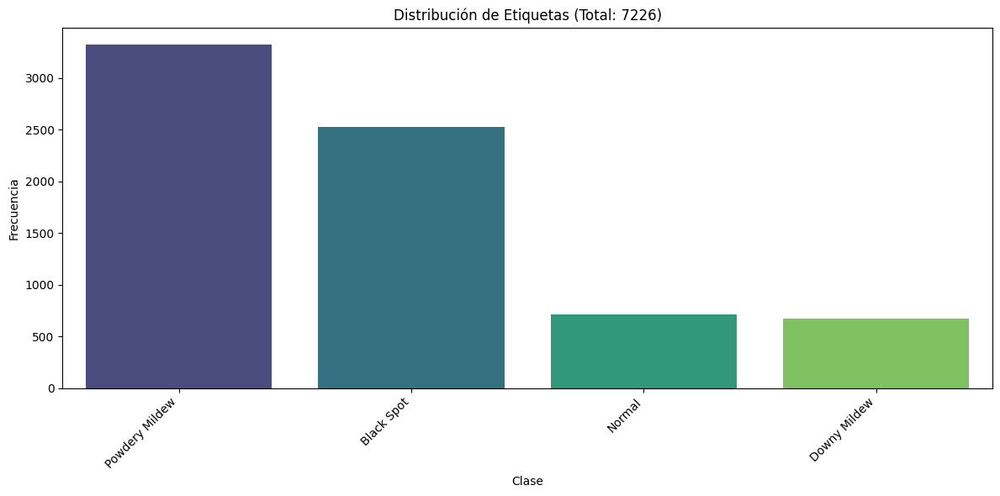


 Generando ejemplos visuales...


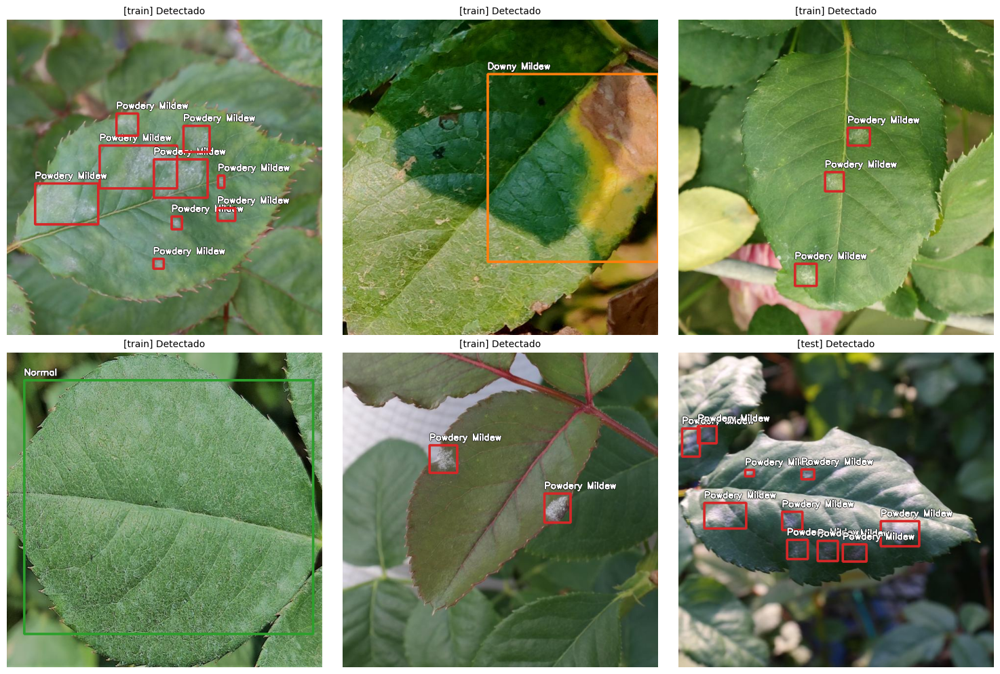

In [ ]:
analizar_yolo_dataset( dataset_dir)

### 2. Entrenamiento

Ahora se procede al entrenamiento, parea ello guardo los datos en google drive , donde se pueden observar graficas, matrices de confusión ...

Los entrenamiento se realizaran con modelo yolo11 medium . Se puede llegar a mas precisión , al ser un conjunto de prueba y solo querer saber cual se comporta mejor  se dejara a 25 epocas.

In [ ]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Rosas_NoAug"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir' not in globals():
    print("Error: La variable 'dataset_dir' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir}")

    ruta_yaml = os.path.join(dataset_dir, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_rosas_No_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/rose-leaf-diseases-5
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/rose-leaf-diseases-5/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_rosas_No_AUG

## 1.2 Prueba con data Augmentation

Emplearemos el dataset https://universe.roboflow.com/germanrv/rose-leaf-diseases-gboa4 en su versión "V2_DataAug"

 En este caso , utilizando las herramientas proporcionadas por roboflow, se le ha aplicado las siguientes transformaciones:


*  Flip: Horizontal, Vertical
*  90° Rotate: Clockwise, Counter-Clockwise, Upside Down
* Crop: 0% Minimum Zoom, 13% Maximum Zoom
*  Rotation: Between -6° and +6°
*  Saturation: Between -12% and +12%
*  rightness: Between -15% and +15%


###  1. Carga del dataset desde Roboflow

In [ ]:
rf = Roboflow(api_key="optsSQIAxiNXEdI8izmp")
project = rf.workspace("germanrv").project("rose-leaf-diseases-gboa4")
version = project.version(6)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to rose-leaf-diseases-6 in yolov11:: 100%|██████████| 12946/12946 [00:01<00:00, 8067.85it/s] 


In [ ]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/rose-leaf-diseases-6


### 2. Configurar Yaml

In [ ]:
if dataset_dir:
   configurar_yaml(dataset_dir)


Archivo corregido: /content/rose-leaf-diseases-6/data.yaml
Clases: ['Black Spot', 'Downy Mildew', 'Normal', 'Powdery Mildew']


### 3. Distribuir Datos

Los datos han sido distribuidos con 70 15 15 debido a que en este dataset en autor lo hacia de esta forma y se ven buenos resultados. Otra razón por la que ha hecho esta distribución ha sido por que al aplicar data augmentation se quedaba desbalanceado.

In [ ]:
dataset_dir_final = redistribuir_dataset(dataset_dir, "/content/dataset_repartido")


 INICIANDO REDISTRIBUCIÓN desde: /content/rose-leaf-diseases-6
   -> Recolectadas 5613 parejas de 'train'
   -> Recolectadas 427 parejas de 'valid'
   -> Recolectadas 427 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 6467

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 4526 imágenes generadas.
   VALID: 970 imágenes generadas.
   TEST: 971 imágenes generadas.

 PROCESO COMPLETADO. nuevo dataset está en: /content/dataset_repartido


### 4. Analizar dataset

In [ ]:
analizar_estructura(dataset_dir_final)


REPORTE DEL DATASET (Carpeta: /content/dataset_repartido)
--------------------------------------------------
TRAIN: 4526 imágenes encontradas.
VALID: 970 imágenes encontradas.
TEST: 971 imágenes encontradas.
--------------------------------------------------
TOTAL: 6467 imágenes.


 Clases detectadas: ['Black Spot', 'Downy Mildew', 'Normal', 'Powdery Mildew']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
Powdery Mildew                 | 7793      
Black Spot                     | 5980      
Normal                         | 1690      
Downy Mildew                   | 1593      


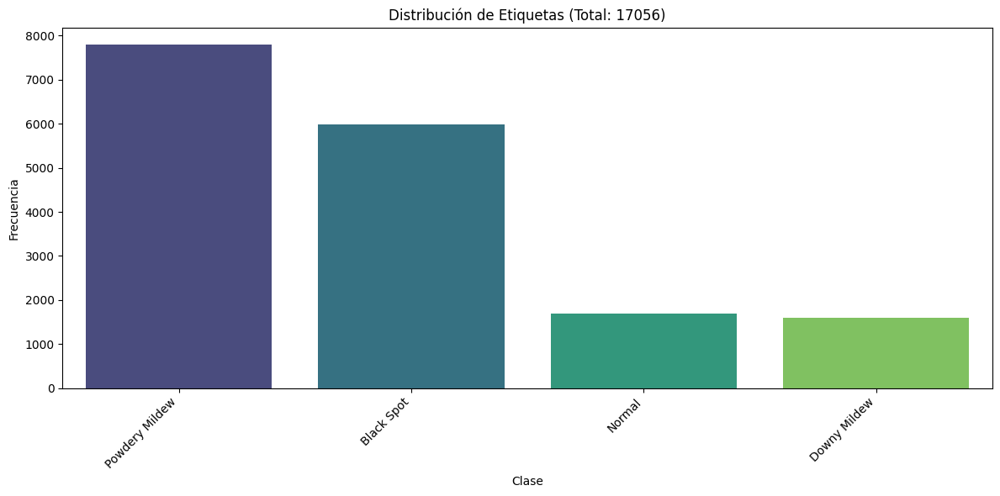


 Generando ejemplos visuales...


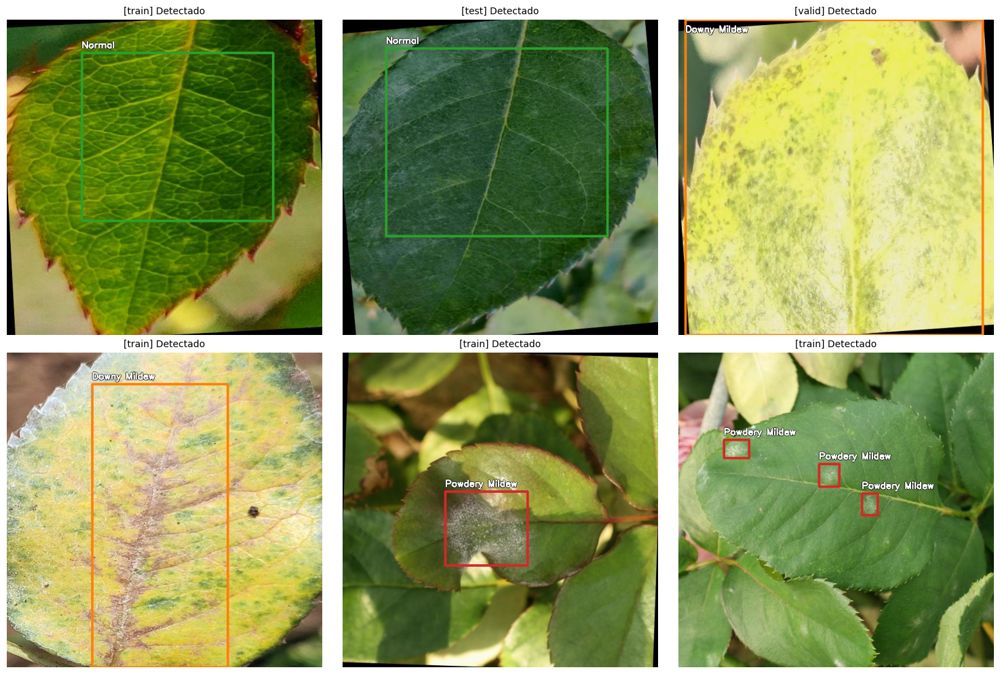

In [ ]:
analizar_yolo_dataset( dataset_dir_final)

### 5. Entrenamiento

In [ ]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Rosas_Aug"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final}")

    ruta_yaml = os.path.join(dataset_dir_final, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_rosas_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_rosas_AUG, nbs=64,

## 1.3 Analisis de Resultados

Version sin Data Augmentation

           -     Class     Images  Instances      Box(P         R      mAP50     mAP50-95)
                   all        427       1039      0.882      0.862      0.909      0.518
            Black Spot        103        371      0.889      0.841      0.916      0.653
          Downy Mildew        102        103      0.887      0.914      0.893      0.495
                Normal        113        113      0.933      0.965      0.981      0.513
        Powdery Mildew        110        452      0.819       0.73      0.846      0.412

Version con Data Augmentation

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        970       2445      0.904      0.882      0.922      0.539
            Black Spot        254        870       0.86      0.883      0.924      0.659
          Downy Mildew        254        260      0.945      0.927      0.949      0.535
                Normal        254        254      0.979      0.984      0.976      0.547
        Powdery Mildew        215       1061      0.833      0.732      0.841      0.414

Analizando los resultados se ve un ligera mejoria en el dataset con Data Augmentation  obteniendo mejores resultados en cada clase , por consecuencia sera elegido la version con Data Augmentation

Tras la ejecución de los experimentos y la evaluación de las métricas obtenidas en el conjunto de prueba, se ha llevado a cabo una comparativa exhaustiva entre la versión base (sin Data Augmentation) y la versión entrenada utilizando Data Augmentation.

**Comparativa Global de Rendimiento**

La evaluación cuantitativa determina que el modelo entrenado con Data Augmentation ofrece un desempeño superior en todas las métricas clave.

1. Precisión Media (mAP): La métrica más robusta para la detección de objetos, mAP50-95, experimentó un incremento del 0.518 en la versión base al 0.539 en la versión aumentada.

2. Precision  y Recall: Se observa un comportamiento más equilibrado y robusto en la versión con data Augmentation:
   - Precision: Aumentó de 0.882 a 0.904, lo que indica una reducción en los falsos positivos .
   - Recall: Aumentó de 0.862 a 0.882, lo que implica que el modelo es capaz de encontrar una mayor cantidad de instancias reales de enfermedad, reduciendo los falsos negativos.

**Análisis por Clases**

Al desglosar el rendimiento por cada tipología de enfermedad, se destacan los siguientes hallazgos:

- `Downy Mildew`: Fue la clase más beneficiada por el aumento de datos, pasando de un mAP50-95 de 0.495 a 0.535. Esto sugiere que las transformaciones geométricas y de color ayudaron al modelo a generalizar mejor las características visuales de este mildiu .
-` Normal` (Hojas sanas): Esta clase presenta el mejor rendimiento en ambos escenarios, alcanzando un mAP50-95 de 0.547 en la versión final. La alta precisión (0.979) confirma que el sistema es muy fiable para descartar falsas alarmas en hojas sanas.
- `Powdery Mildew`: Se identifica como la clase más compleja de detectar, manteniendo un rendimiento similar en ambos modelos (mAP50-95 en torno a 0.41). Esto sugiere que la variabilidad visual de este hongo requiere una atención específica en trabajos futuros, posiblemente debido a su similitud visual con otras manchas o reflejos.

**Robustez y Generalización**

Un factor crítico para la selección del mejor modelo es el tamaño del conjunto de evaluación. La versión con Data Augmentation fue validada sobre un conjunto de prueba  mayor (970 imágenes frente a 427). El hecho de obtener mejores métricas sobre un conjunto de datos más extenso y variado (más del doble de tamaño) aporta una mayor significancia estadística a los resultados. Esto confirma que el modelo no solo ha memorizado los datos de entrenamiento, sino que posee una capacidad de generalización superior ante nuevas muestras.



## 1.4 Torneo mejor version Yolo

In [ ]:


import gc
import torch
import os
import shutil
import time
import pandas as pd
from ultralytics import YOLO
from google.colab import drive

# --- Configuración del entorno ---

# Montar Google Drive
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta para guardar los resultados
DRIVE_BASE = "/content/drive/MyDrive/Torneo_YOLO_Rosa_Final"
os.makedirs(DRIVE_BASE, exist_ok=True)

# Lista de modelos a evaluar
contendientes = [
    # YOLOv3
    {"nombre": "yolov3-tiny.pt",  "batch": 16},
    {"nombre": "yolov3.pt",  "batch": 16},

    # YOLOv5
    {"nombre": "yolov5n.pt",  "batch": 16},
    {"nombre": "yolov5s.pt",  "batch": 16},

    # YOLOv8
    {"nombre": "yolov8n.pt", "batch": 16},
    {"nombre": "yolov8s.pt", "batch": 16},

    # YOLO11
    {"nombre": "yolo11n.pt",  "batch": 16},
    {"nombre": "yolo11s.pt",  "batch": 16},
]

print(f"Total de modelos a comparar: {len(contendientes)}")

tabla_resultados = []

# --- Bucle de entrenamiento ---

for i, luchador in enumerate(contendientes):
    modelo_archivo = luchador["nombre"]
    batch_size = luchador["batch"]
    nombre_combate = modelo_archivo.replace('.pt', '')

    print(f"\nEntrenando modelo {i+1}/{len(contendientes)}: {nombre_combate} (Batch: {batch_size})")c

    # Liberar memoria GPU
    gc.collect()
    torch.cuda.empty_cache()

    start_time = time.time()

    try:
        model = YOLO(modelo_archivo)

        # Entrenamiento
        results = model.train(
            data=f"{dataset_dir}/data.yaml",
            epochs=25,
            imgsz=640,
            batch=batch_size,
            device=0 if torch.cuda.is_available() else 'cpu',
            project='Torneo_Local',
            name=nombre_combate,
            patience=10,
            plots=True,
            verbose=False,
            exist_ok=True
        )

        end_time = time.time()
        duracion_min = round((end_time - start_time) / 60, 2)

        # Obtener métricas clave
        metrics = results.box
        map5095 = round(metrics.map, 4)
        map50 = round(metrics.map50, 4)
        precision = round(metrics.mp, 4)
        recall = round(metrics.mr, 4)

        print(f"Entrenamiento finalizado. Tiempo: {duracion_min} min | mAP50-95: {map5095}")

        # Registrar datos
        tabla_resultados.append({
            "Modelo": nombre_combate,
            "Batch": batch_size,
            "Tiempo (min)": duracion_min,
            "mAP50-95": map5095,
            "mAP50": map50,
            "Precision": precision,
            "Recall": recall
        })

        # Copiar resultados a Drive
        origen = f"/content/Torneo_Local/{nombre_combate}"
        destino = f"{DRIVE_BASE}/{nombre_combate}"

        if os.path.exists(destino):
            shutil.rmtree(destino)

        shutil.copytree(
            origen,
            destino,
            ignore=shutil.ignore_patterns('last.pt', 'optimizer.pt', '*.onnx')
        )

    except Exception as e:
        print(f"Error entrenando {nombre_combate}: {e}")
        tabla_resultados.append({
            "Modelo": nombre_combate,
            "Batch": batch_size,
            "Tiempo (min)": 0,
            "mAP50-95": 0,
            "mAP50": 0,
            "Precision": 0,
            "Recall": 0
        })
        continue

# --- Generación de informe final ---

print("\nTabla de Resultados Finales:")

df = pd.DataFrame(tabla_resultados)

if not df.empty and 'mAP50-95' in df.columns:
    df = df.sort_values(by='mAP50-95', ascending=False)

print(df.to_string(index=False))

# Guardar CSV en Drive
csv_path = f"{DRIVE_BASE}/Resultados_Torneo.csv"
df.to_csv(csv_path, index=False)
print(f"Informe guardado en: {csv_path}")

Total de modelos a comparar: 8

Entrenando modelo 1/8: yolov3-tiny (Batch: 16)
PRO TIP 💡 Replace 'model=yolov3-tiny.pt' with new 'model=yolov3-tinyu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.

Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/rose-leaf-diseases-6/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.

# 2. Dataset PATATAS

https://universe.roboflow.com/germanrv/potatoes_leaf-diseases

Se ha utilizado un dataset sobre enfermedades en Hojas de Patatas, el dataset tiene un tamaño de imágenes de 640 x 640 y 3 clases: `Early Blight`, `Late Blight` y `Healthy`.

`Early Blight` (Tizón Temprano), una enfermedad fúngica muy común causada por el hongo Alternaria solani. Se manifiesta inicialmente en las hojas más viejas como pequeñas manchas marrones que crecen formando anillos concéntricos.Debilita la planta reduciendo su capacidad fotosintética y el rendimiento del cultivo.

`Late Blight` (Tizón Tardío), considerada la enfermedad más devastadora de la patata, provocada por el oomiceto Phytophthora infestans. Se caracteriza por manchas grandes, irregulares y de aspecto necrótico (negro/marrón).

`Healthy` (Sana), hoja en estado fisiológico óptimo, sin presencia de manchas, decoloraciones ni signos de estrés biótico.

## 2.1. Dataset PATATAS (SIN DataAugmentation)

Emplearemos el dataset https://universe.roboflow.com/germanrv/potatoes_leaf-diseases en su versión "V2_NoDataAug"

### 1. Carga del dataset desde Roboflow

In [ ]:
rf = Roboflow(api_key="optsSQIAxiNXEdI8izmp")
project = rf.workspace("germanrv").project("potatoes_leaf-diseases")
version = project.version(4)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...


In [ ]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/Potatoes_leaf-diseases-4


### 2. Configurar Yaml

In [ ]:
if dataset_dir:
    configurar_yaml(dataset_dir)


Archivo corregido: /content/Potatoes_leaf-diseases-4/data.yaml
Clases: ['early bright', 'healthy', 'late bright']


### 1. Prueba sin repartir

#### 1. Analizar Dataset

In [ ]:
analizar_estructura(dataset_dir)


REPORTE DEL DATASET (Carpeta: /content/Potatoes_leaf-diseases-4)
--------------------------------------------------
TRAIN: 613 imágenes encontradas.
VALID: 101 imágenes encontradas.
TEST: 98 imágenes encontradas.
--------------------------------------------------
TOTAL: 812 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 6354      
late bright                    | 565       
healthy                        | 152       


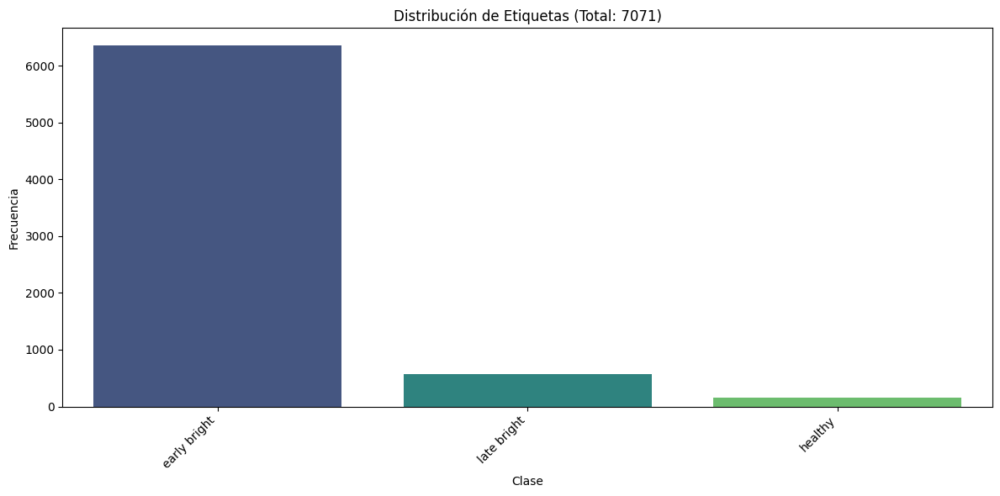


 Generando ejemplos visuales...


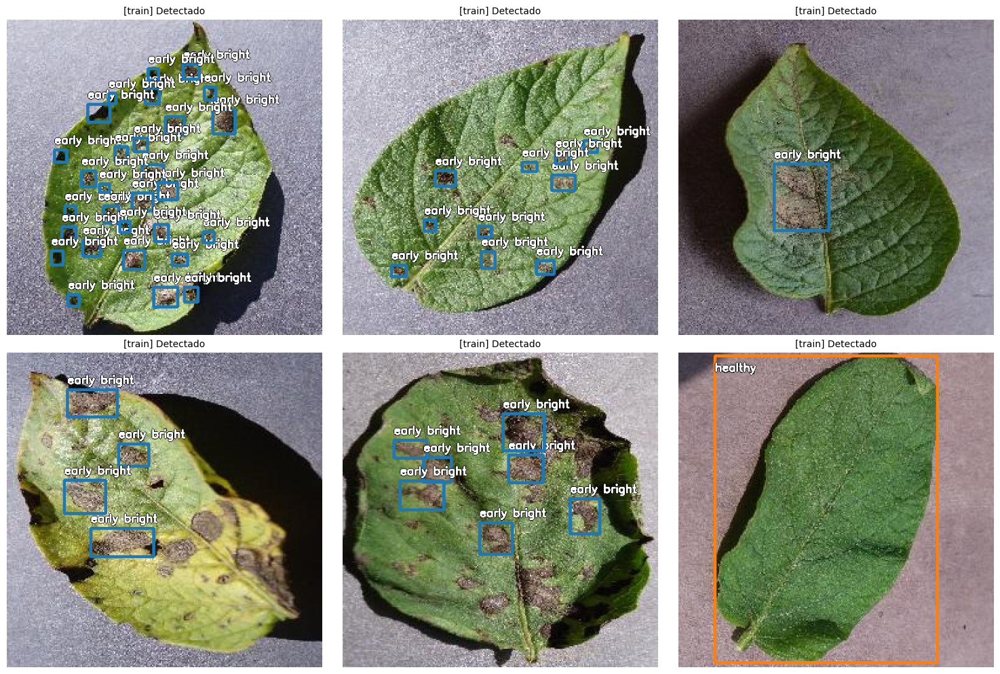

In [ ]:
analizar_yolo_dataset( dataset_dir)

#### 2. Entrenamiento

In [ ]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_No_Aug"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir' not in globals():
    print("Error: La variable 'dataset_dir' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir}")

    ruta_yaml = os.path.join(dataset_dir, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_No_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/Potatoes_leaf-diseases-4
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Potatoes_leaf-diseases-4/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_pata

### 2. Prueba con 70/15/15

#### 1. Distribuir Dataset

In [ ]:
dataset_dir_final = redistribuir_dataset(dataset_dir, "/content/dataset_repartido")


 INICIANDO REDISTRIBUCIÓN desde: /content/Potatoes_leaf-diseases-4
   -> Recolectadas 613 parejas de 'train'
   -> Recolectadas 101 parejas de 'valid'
   -> Recolectadas 98 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 812

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 568 imágenes generadas.
   VALID: 121 imágenes generadas.
   TEST: 123 imágenes generadas.

 PROCESO COMPLETADO. Tu nuevo dataset está en: /content/dataset_repartido


#### 2. Analizar Dataset

In [ ]:
analizar_estructura(dataset_dir_final)


REPORTE DEL DATASET (Carpeta: /content/dataset_repartido)
--------------------------------------------------
TRAIN: 568 imágenes encontradas.
VALID: 121 imágenes encontradas.
TEST: 123 imágenes encontradas.
--------------------------------------------------
TOTAL: 812 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 6354      
late bright                    | 565       
healthy                        | 152       


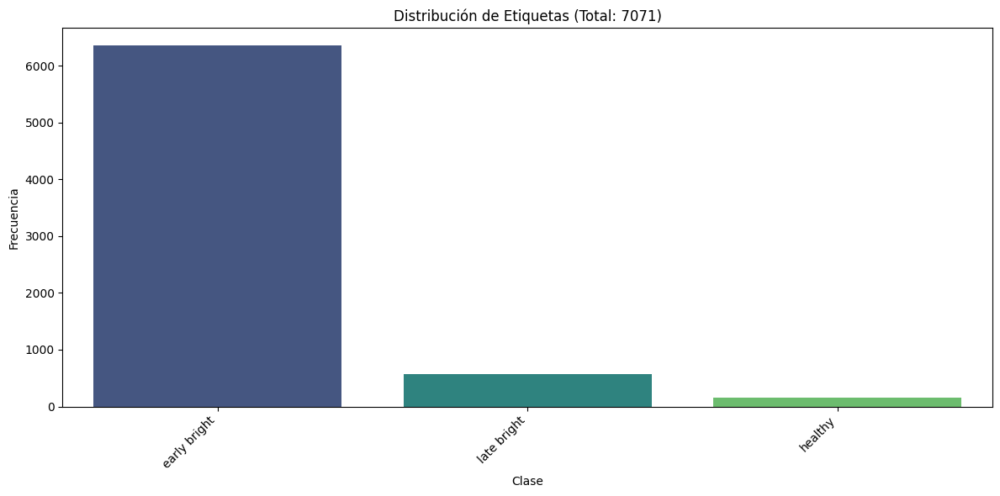


 Generando ejemplos visuales...


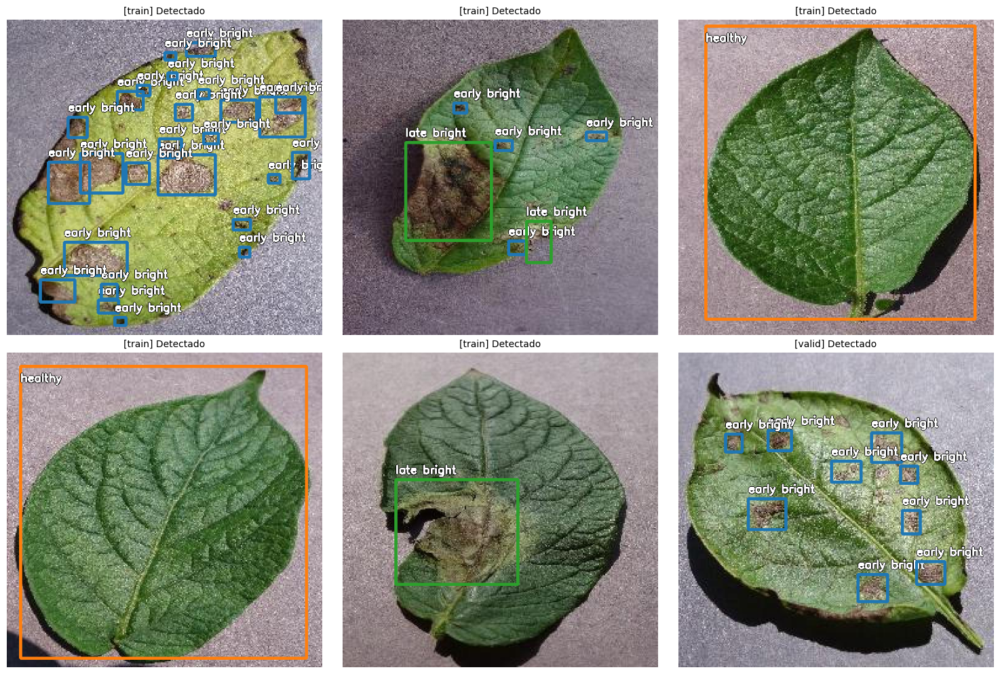

In [ ]:
analizar_yolo_dataset( dataset_dir_final)

#### 4. Entrenamiento

In [ ]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_No_Aug_70"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final}")

    ruta_yaml = os.path.join(dataset_dir_final, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_AUG_70'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_patatas_AUG_70, nb

## 2.2. Dataset PATATAS (Con DataAugmentation)

Emplearemos el dataset https://universe.roboflow.com/germanrv/potatoes_leaf-diseases en su versión "V2_DataAug"

In [ ]:

from roboflow import Roboflow
rf = Roboflow(api_key="optsSQIAxiNXEdI8izmp")
project = rf.workspace("germanrv").project("potatoes_leaf-diseases")
version = project.version(3)
dataset = version.download("yolov11")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Potatoes_leaf-diseases-3 in yolov11:: 100%|██████████| 4088/4088 [00:00<00:00, 7882.61it/s]


In [ ]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/Potatoes_leaf-diseases-3


In [ ]:
if dataset_dir:
    configurar_yaml(dataset_dir)


Archivo corregido: /content/Potatoes_leaf-diseases-3/data.yaml
Clases: ['early bright', 'healthy', 'late bright']


### 1. Prueba sin repartir

#### 1. Analizar Dataset

In [ ]:
analizar_estructura(dataset_dir)


REPORTE DEL DATASET (Carpeta: /content/Potatoes_leaf-diseases-3)
--------------------------------------------------
TRAIN: 1839 imágenes encontradas.
VALID: 101 imágenes encontradas.
TEST: 98 imágenes encontradas.
--------------------------------------------------
TOTAL: 2038 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 18068     
late bright                    | 1379      
healthy                        | 364       


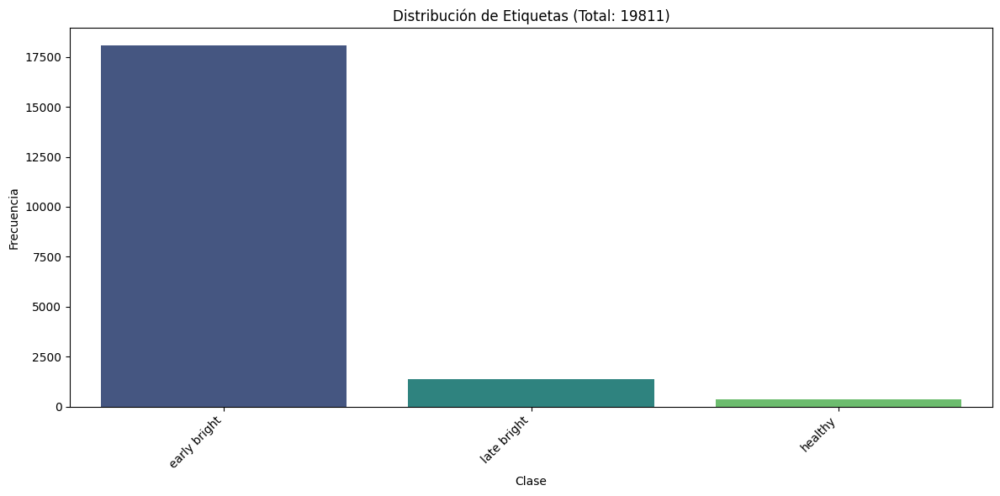


 Generando ejemplos visuales...


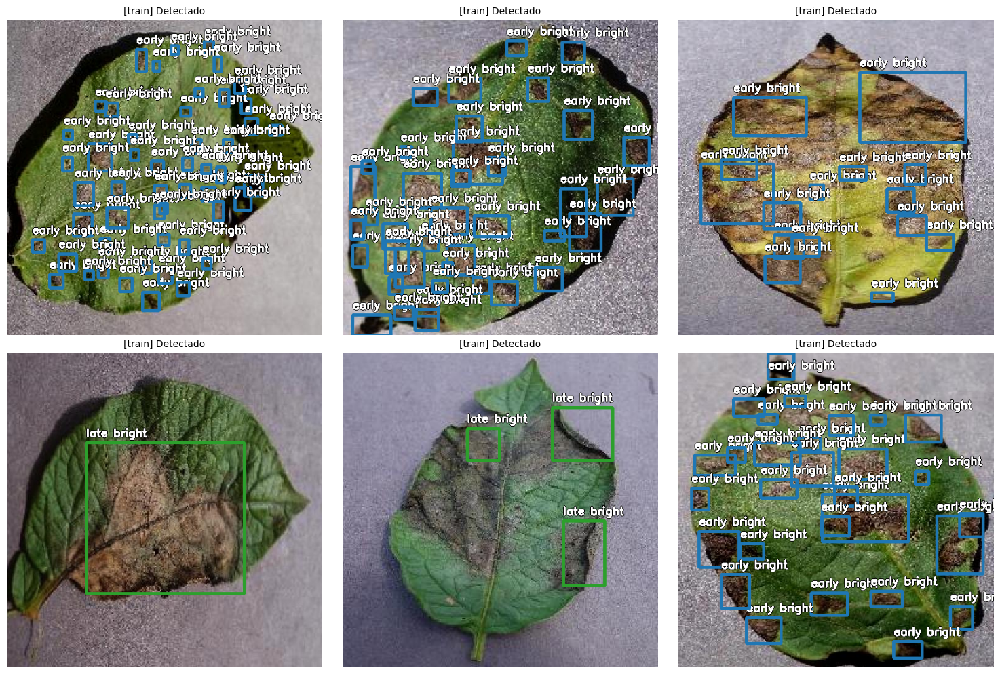

In [ ]:
analizar_yolo_dataset( dataset_dir)

#### 2. Entrenamiento

In [ ]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_Aug"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir' not in globals():
    print("Error: La variable 'dataset_dir' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir}")

    ruta_yaml = os.path.join(dataset_dir, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/Potatoes_leaf-diseases-3
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Potatoes_leaf-diseases-3/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_pata

### 2. Prueba con 70/15/15

#### 1. Distribuir Dataset

In [ ]:
dataset_dir_final_70 = redistribuir_dataset(dataset_dir, "/content/dataset_repartido")


 INICIANDO REDISTRIBUCIÓN desde: /content/Potatoes_leaf-diseases-3
   -> Recolectadas 1839 parejas de 'train'
   -> Recolectadas 101 parejas de 'valid'
   -> Recolectadas 98 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 2038

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 1426 imágenes generadas.
   VALID: 305 imágenes generadas.
   TEST: 307 imágenes generadas.

 PROCESO COMPLETADO. nuevo dataset está en: /content/dataset_repartido


#### 2. Analizar Dataset

In [ ]:
analizar_estructura(dataset_dir_final_70)


REPORTE DEL DATASET (Carpeta: /content/dataset_repartido)
--------------------------------------------------
TRAIN: 1426 imágenes encontradas.
VALID: 305 imágenes encontradas.
TEST: 307 imágenes encontradas.
--------------------------------------------------
TOTAL: 2038 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 18068     
late bright                    | 1379      
healthy                        | 364       


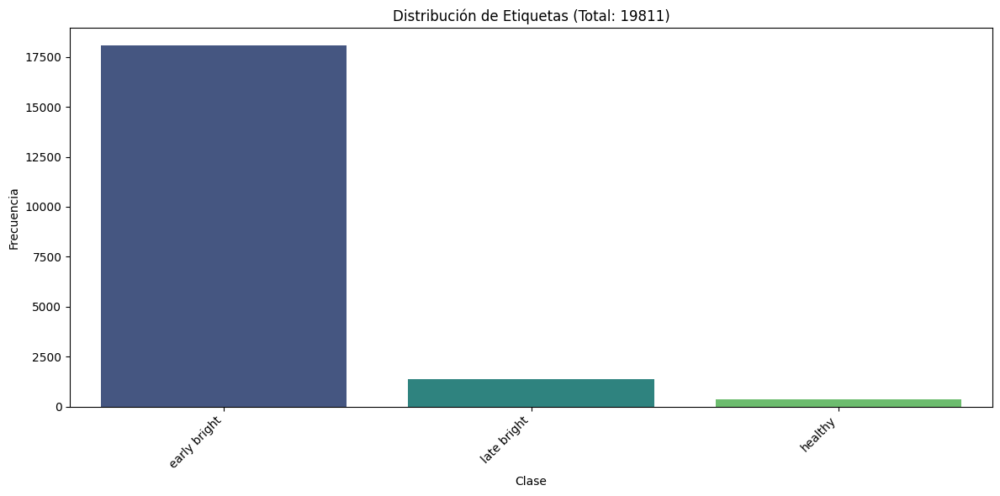


 Generando ejemplos visuales...


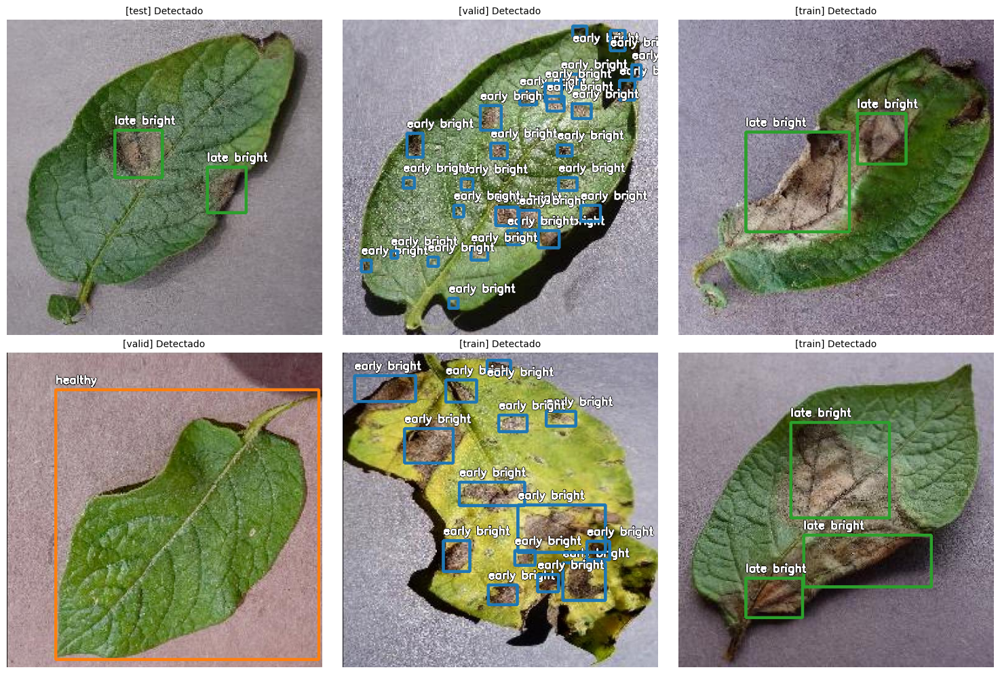

In [ ]:
analizar_yolo_dataset( dataset_dir_final_70)

#### 3. Entrenamiento

In [ ]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_Aug_70"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final_70' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final_70}")

    ruta_yaml = os.path.join(dataset_dir_final_70, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_AUG_70'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_patatas_AUG_702, n

### 3. Prueba 80/10/10

#### 1. Distribuir Dataset

In [ ]:
dataset_dir_final = redistribuir_dataset(dataset_dir, "/content/dataset_repartido",0.8,0.1,0.1)


 INICIANDO REDISTRIBUCIÓN desde: /content/Potatoes_leaf-diseases-3
   -> Recolectadas 1839 parejas de 'train'
   -> Recolectadas 101 parejas de 'valid'
   -> Recolectadas 98 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 2038

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 1630 imágenes generadas.
   VALID: 203 imágenes generadas.
   TEST: 205 imágenes generadas.

 PROCESO COMPLETADO. nuevo dataset está en: /content/dataset_repartido


#### 2. Analizar Dataset

In [ ]:
analizar_estructura(dataset_dir)


REPORTE DEL DATASET (Carpeta: /content/Potatoes_leaf-diseases-3)
--------------------------------------------------
TRAIN: 1839 imágenes encontradas.
VALID: 101 imágenes encontradas.
TEST: 98 imágenes encontradas.
--------------------------------------------------
TOTAL: 2038 imágenes.


 Clases detectadas: ['early bright', 'healthy', 'late bright']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
early bright                   | 18068     
late bright                    | 1379      
healthy                        | 364       


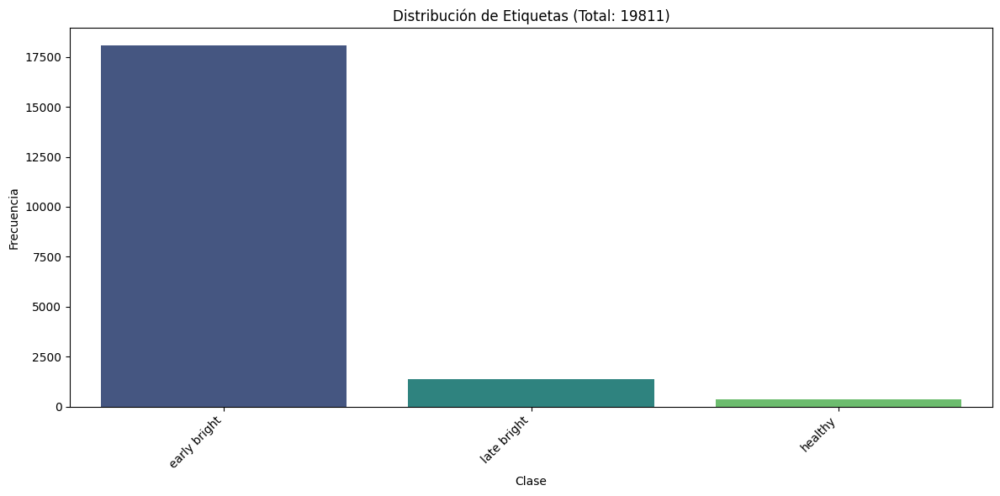


 Generando ejemplos visuales...


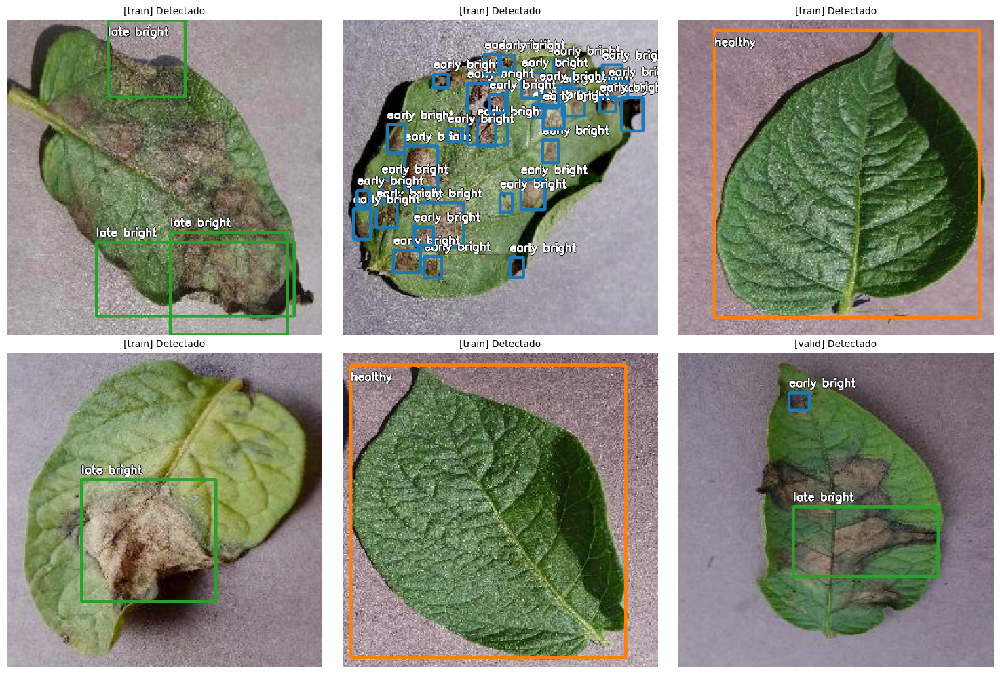

In [ ]:
analizar_yolo_dataset( dataset_dir)

#### 3. Entrenamiento

In [ ]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Patatas_Aug_80"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final}")

    ruta_yaml = os.path.join(dataset_dir_final, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_patatas_AUG_80'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_patatas_AUG_80, nb

## 2.3 Analisis de Resultados

Version No Data

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        101        194      0.663      0.724      0.686      0.492
          early bright         22         68      0.271      0.529      0.321      0.208
               healthy         31         31      0.977          1      0.995      0.959
           late bright         60         95      0.741      0.642      0.742      0.308

Version No Data 70/15/15

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        121       1049      0.729      0.743      0.753      0.525
          early bright         64        953      0.616      0.686      0.657      0.442
               healthy         24         24      0.965          1      0.995      0.874
           late bright         48         72      0.607      0.542      0.608       0.26

Version Data

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        101        194      0.694      0.736      0.706      0.505
          early bright         22         68      0.377      0.544      0.369      0.233
               healthy         31         31      0.982          1      0.995      0.966
           late bright         60         95      0.724      0.663      0.755      0.317

Version Data 70/15/15

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        305       2792      0.798      0.781      0.801      0.582
          early bright        159       2531      0.659       0.74      0.723      0.481
               healthy         56         56      0.983          1      0.995      0.964
           late bright        134        205      0.751      0.603      0.685      0.301

Version Data 80/10/10

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all        203       1820      0.811      0.789      0.801      0.581
          early bright        111       1616      0.633      0.749      0.687      0.442
               healthy         32         32      0.978          1      0.995      0.971
           late bright         88        172      0.822      0.619       0.72       0.33

Tras realizar una comparativa exhaustiva entre las diferentes configuraciones de entrenamiento y distribución de datos , se ha determinado que la mejor version corresponde al modelo entrenado con la distribución 70/15/15 con Data Augmentation.Se ha decidido siguiendo estas metricas:

1. Superioridad en la Métrica Global (mAP)
El indicador más robusto para evaluar la precisión general de un modelo de detección de objetos es el mAP50-95. La versión 70/15/15 con Data Augmentation obtuvo el valor más alto con un 0.582, superando técnicamente a la versión 80/10/10 (0.581) y mostrando una mejora  significativa respecto a las versiones base (0.492 y 0.505).

2. Desempeño en Clases Críticas
El análisis detallado por clases revela que la versión 70/15/15 gestiona mejor la clase más compleja y abundante del conjunto de datos `early bright`. Esta clase cuenta con 2531 instancias (frente a las pocas cientos de las otras clases) y suele ser la más difícil de detectar debido a la sutileza de los síntomas tempranos. En esta categoría específica, el modelo seleccionado alcanzó un mAP50-95 de 0.481, superando notablemente el 0.442 obtenido por la versión 80/10/10. Esto demuestra que el modelo 70/15/15 tiene una mayor capacidad de generalización.

3. Confiabilidad de la Validación
Un factor determinante para la elección es la representatividad de los resultados. La versión 70/15/15 fue evaluada sobre un conjunto de validación de 305 imágenes, a diferencia de las 203 imágenes utilizadas en la versión 80/10/10 o las 101 imágenes de las versiones iniciales.



## 2.4. Torneo Yolo

In [ ]:


import gc
import torch
import os
import shutil
import time
import pandas as pd
from ultralytics import YOLO
from google.colab import drive

# --- Configuración del entorno ---

# Montar Google Drive
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta para guardar los resultados
DRIVE_BASE = "/content/drive/MyDrive/Torneo_YOLO_patatas_Final"
os.makedirs(DRIVE_BASE, exist_ok=True)

# Lista de modelos a evaluar
contendientes = [
    # YOLOv3
    {"nombre": "yolov3-tiny.pt",  "batch": 16},
    {"nombre": "yolov3s.pt",  "batch": 16},

    # YOLOv5
    {"nombre": "yolov5n.pt",  "batch": 16},
    {"nombre": "yolov5s.pt",  "batch": 16},

    # YOLOv8
    {"nombre": "yolov8n.pt", "batch": 16},
    {"nombre": "yolov8s.pt", "batch": 16},

    # YOLO11
    {"nombre": "yolo11n.pt",  "batch": 16},
    {"nombre": "yolo11s.pt",  "batch": 16},
]

print(f"Total de modelos a comparar: {len(contendientes)}")

tabla_resultados = []

# --- Bucle de entrenamiento ---

for i, luchador in enumerate(contendientes):
    modelo_archivo = luchador["nombre"]
    batch_size = luchador["batch"]
    nombre_combate = modelo_archivo.replace('.pt', '')

    print(f"\nEntrenando modelo {i+1}/{len(contendientes)}: {nombre_combate} (Batch: {batch_size})")

    # Liberar memoria GPU
    gc.collect()
    torch.cuda.empty_cache()

    start_time = time.time()

    try:
        model = YOLO(modelo_archivo)

        # Entrenamiento
        results = model.train(
            data=f"{dataset_dir_final_70}/data.yaml",
            epochs=25,
            imgsz=640,
            batch=batch_size,
            device=0 if torch.cuda.is_available() else 'cpu',
            project='Torneo_Local',
            name=nombre_combate,
            patience=10,
            plots=True,
            verbose=False,
            exist_ok=True
        )

        end_time = time.time()
        duracion_min = round((end_time - start_time) / 60, 2)

        # Obtener métricas clave
        metrics = results.box
        map5095 = round(metrics.map, 4)
        map50 = round(metrics.map50, 4)
        precision = round(metrics.mp, 4)
        recall = round(metrics.mr, 4)

        print(f"Entrenamiento finalizado. Tiempo: {duracion_min} min | mAP50-95: {map5095}")

        # Registrar datos
        tabla_resultados.append({
            "Modelo": nombre_combate,
            "Batch": batch_size,
            "Tiempo (min)": duracion_min,
            "mAP50-95": map5095,
            "mAP50": map50,
            "Precision": precision,
            "Recall": recall
        })

        # Copiar resultados a Drive
        origen = f"/content/Torneo_Local/{nombre_combate}"
        destino = f"{DRIVE_BASE}/{nombre_combate}"

        if os.path.exists(destino):
            shutil.rmtree(destino)

        shutil.copytree(
            origen,
            destino,
            ignore=shutil.ignore_patterns('last.pt', 'optimizer.pt', '*.onnx')
        )

    except Exception as e:
        print(f"Error entrenando {nombre_combate}: {e}")
        tabla_resultados.append({
            "Modelo": nombre_combate,
            "Batch": batch_size,
            "Tiempo (min)": 0,
            "mAP50-95": 0,
            "mAP50": 0,
            "Precision": 0,
            "Recall": 0
        })
        continue

# --- Generación de informe final ---

print("\nTabla de Resultados Finales:")

df = pd.DataFrame(tabla_resultados)

if not df.empty and 'mAP50-95' in df.columns:
    df = df.sort_values(by='mAP50-95', ascending=False)

print(df.to_string(index=False))

# Guardar CSV en Drive
csv_path = f"{DRIVE_BASE}/Resultados_Torneo.csv"
df.to_csv(csv_path, index=False)
print(f"Informe guardado en: {csv_path}")

Total de modelos a comparar: 8

Entrenando modelo 1/8: yolov3-tiny (Batch: 16)
PRO TIP 💡 Replace 'model=yolov3-tiny.pt' with new 'model=yolov3-tinyu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.

Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, 

# 3. Dataset Manzanas

emplearemos el dataset https://universe.roboflow.com/gfsm/manzanas-tofsb/dataset/1

Se ha utilizado un dataset sobre enfermedades en Hojas de Manzanas, el dataset tiene un tamaño de imágenes de 640 x 640 y 5 clases: `Alternaria Leaf Spot`, `Brown Spot`, `Gray Spot`, `Rus` y `Healthy Leaf`.

`Alternaria Leaf Spot` (Mancha de Alternaria), una enfermedad fúngica causada principalmente por el género Alternaria . Se manifiesta inicialmente como pequeñas manchas circulares de color marrón o negro que pueden expandirse formando anillos concéntricos. Provoca una defoliación severa en verano, debilitando el árbol y reduciendo el rendimiento de la cosecha.

`Brown Spot` (Mancha Marrón), patología caracterizada por la aparición de lesiones necróticas de color marrón oscuro en la superficie foliar. A medida que la infección avanza, estas manchas pueden fusionarse cubriendo grandes áreas de la hoja, interfiriendo drásticamente con la fotosíntesis y llevando a un amarilleamiento prematuro.

`Gray Spot` (Mancha Gris), se identifica por la presencia de lesiones irregulares con un centro característico de color grisáceo o pardo pálido, a menudo rodeadas por un borde más oscuro. Estas lesiones necróticas rompen la uniformidad del tejido verde y son indicativas de infecciones fúngicas que deterioran la salud general del follaje.

`Rust` (Roya del Cedro-Manzano), una enfermedad visualmente muy distintiva causada por el hongo Gymnosporangium juniperi-virginianae. Se identifica fácilmente por la aparición de manchas brillantes de color amarillo-anaranjado o rojizo en el haz de las hojas.  A diferencia de otras manchas necróticas, estas lesiones suelen tener una apariencia hinchada o abultada.

`Healthy Leaf` (Hoja Sana), hoja que conserva su color verde vigoroso y estructura intacta, libre de manchas, deformaciones o signos de estrés patológico.

## 3.1 Dataset Manzanas(sin Data Augmentation)

### 1. Cargar del datased desde roboflow

In [ ]:
rf = Roboflow(api_key="qPoFRdUTtADDbtZqHuWp")
project = rf.workspace("gfsm").project("manzanas-tofsb")
version = project.version(2)
dataset = version.download("yolov11")


loading Roboflow workspace...
loading Roboflow project...


In [ ]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/manzanas-2


### 2. Distribuir Dataset

In [ ]:
dataset_dir_final = redistribuir_dataset(dataset_dir, "/content/dataset_repartido")


 INICIANDO REDISTRIBUCIÓN desde: /content/manzanas-2
   -> Recolectadas 1111 parejas de 'train'
   -> Recolectadas 233 parejas de 'valid'
   -> Recolectadas 238 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 1582

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 1107 imágenes generadas.
   VALID: 237 imágenes generadas.
   TEST: 238 imágenes generadas.

 PROCESO COMPLETADO. nuevo dataset está en: /content/dataset_repartido


### 2. Configurar Yaml

In [ ]:
if dataset_dir_final:
    configurar_yaml(dataset_dir_final)


Archivo corregido: /content/dataset_repartido/data.yaml
Clases: ['Alternaria_Leaf_Spot', 'Brown_Spot', 'Gray_Spot', 'Healthy_Leaf', 'Rust']


### 3. Analizar Dataset

In [ ]:
analizar_estructura(dataset_dir_final)


REPORTE DEL DATASET (Carpeta: /content/dataset_repartido)
--------------------------------------------------
TRAIN: 1107 imágenes encontradas.
VALID: 237 imágenes encontradas.
TEST: 238 imágenes encontradas.
--------------------------------------------------
TOTAL: 1582 imágenes.


 Clases detectadas: ['Alternaria_Leaf_Spot', 'Brown_Spot', 'Gray_Spot', 'Healthy_Leaf', 'Rust']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
Gray_Spot                      | 868       
Rust                           | 828       
Brown_Spot                     | 737       
Alternaria_Leaf_Spot           | 476       
Healthy_Leaf                   | 411       


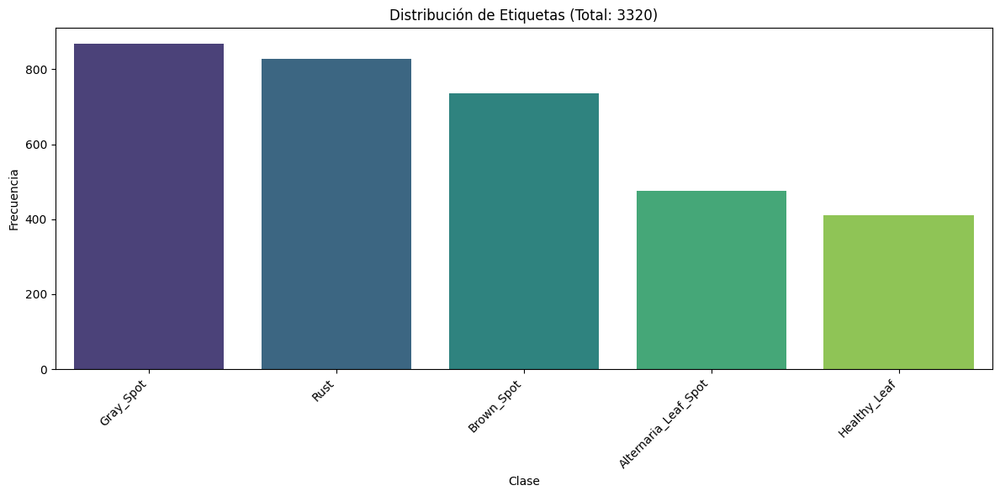


 Generando ejemplos visuales...


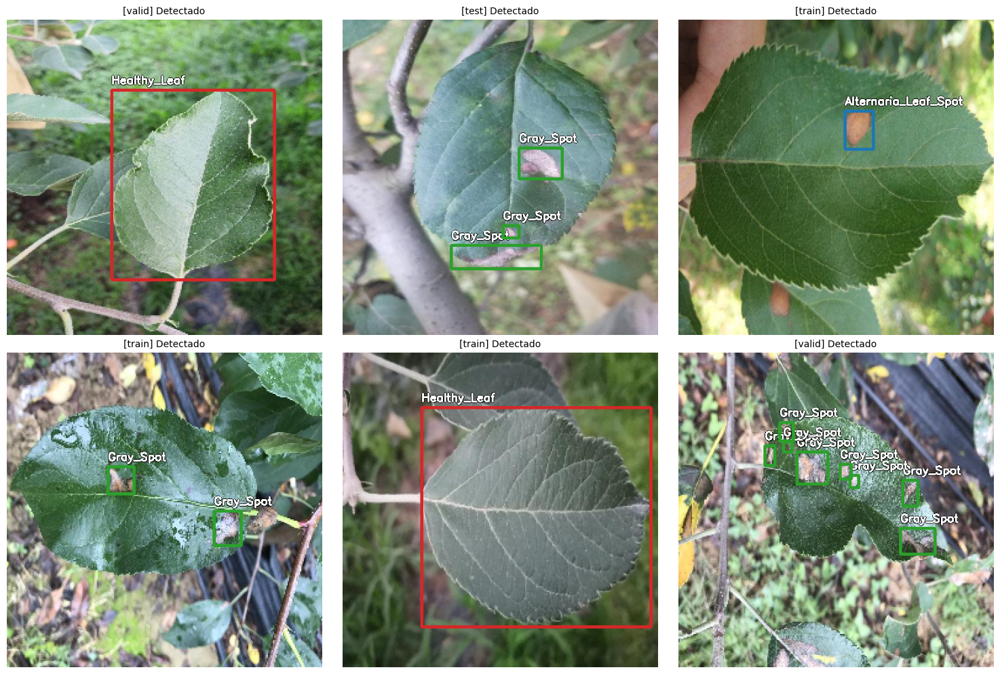

In [ ]:
analizar_yolo_dataset( dataset_dir_final)

### 4. Entrenamiento

In [ ]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Manzanas_No_AUG"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final}")

    ruta_yaml = os.path.join(dataset_dir_final, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_Manzanas_No_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Mounted at /content/drive
Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_Manza

## 3.2 Dataset Manzanas(Data Augmentation)

### 1. Cargar del datased desde roboflow

In [7]:
rf = Roboflow(api_key="qPoFRdUTtADDbtZqHuWp")
project = rf.workspace("gfsm").project("manzanas-tofsb")
version = project.version(1)
dataset = version.download("yolov11")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to manzanas-1 in yolov11:: 100%|██████████| 7620/7620 [00:03<00:00, 1905.98it/s]


In [8]:
dataset_dir = dataset.location
print(f"\n Descarga completada en: {dataset_dir}")


 Descarga completada en: /content/manzanas-1


### 2. Distribuir Dataset

In [9]:
dataset_dir_final = redistribuir_dataset(dataset_dir, "/content/dataset_repartido")


 INICIANDO REDISTRIBUCIÓN desde: /content/manzanas-1
   -> Recolectadas 3333 parejas de 'train'
   -> Recolectadas 233 parejas de 'valid'
   -> Recolectadas 238 parejas de 'test'
 TOTAL DE PARES ENCONTRADOS: 3804

COPIANDO ARCHIVOS A: /content/dataset_repartido ...
   TRAIN: 2662 imágenes generadas.
   VALID: 570 imágenes generadas.
   TEST: 572 imágenes generadas.

 PROCESO COMPLETADO. nuevo dataset está en: /content/dataset_repartido


### 3. Configurar Yaml

In [10]:
if dataset_dir_final:
    configurar_yaml(dataset_dir_final)


Archivo corregido: /content/dataset_repartido/data.yaml
Clases: ['Alternaria_Leaf_Spot', 'Brown_Spot', 'Gray_Spot', 'Healthy_Leaf', 'Rust']


### 4. Analizar Dataset

In [11]:
analizar_estructura(dataset_dir_final)


REPORTE DEL DATASET (Carpeta: /content/dataset_repartido)
--------------------------------------------------
TRAIN: 2662 imágenes encontradas.
VALID: 570 imágenes encontradas.
TEST: 572 imágenes encontradas.
--------------------------------------------------
TOTAL: 3804 imágenes.


 Clases detectadas: ['Alternaria_Leaf_Spot', 'Brown_Spot', 'Gray_Spot', 'Healthy_Leaf', 'Rust']

 Generando estadísticas...

CLASE                          | CANTIDAD  
---------------------------------------------
Gray_Spot                      | 2082      
Rust                           | 2020      
Brown_Spot                     | 1727      
Alternaria_Leaf_Spot           | 1156      
Healthy_Leaf                   | 981       


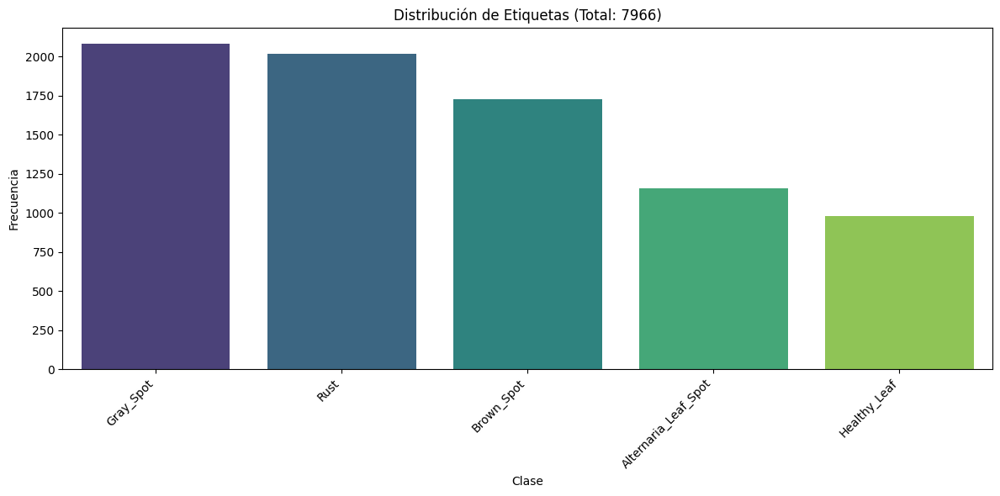


 Generando ejemplos visuales...


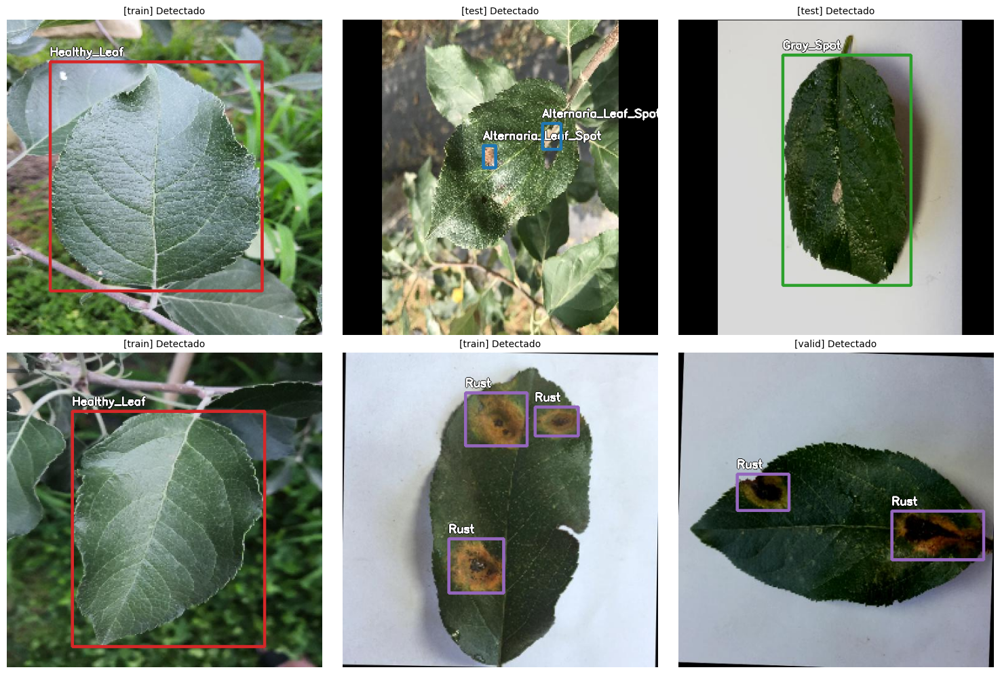

In [12]:
analizar_yolo_dataset( dataset_dir_final)

### 5. Entrenamiento

In [ ]:

#CONFIGURACIÓN DE DRIVE
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta donde se guardarán los resultados permanentemente
DRIVE_OUTPUT = "/content/drive/MyDrive/Torneo_Roboflow_Manzanas_AUG"
os.makedirs(DRIVE_OUTPUT, exist_ok=True)


# ENTRENAMIENTO
if 'dataset_dir_final' not in globals():
    print("Error: La variable 'dataset_dir_final' no está definida.")

else:
    print(f"Usando dataset en: {dataset_dir_final}")

    ruta_yaml = os.path.join(dataset_dir_final, "data.yaml")

    if not os.path.exists(ruta_yaml):
        print(f"Error: No se encuentra el archivo {ruta_yaml}")
    else:
        print("Iniciando entrenamiento con YOLO11m...")

        # Definimos nombres para poder ubicar los archivos después
        PROYECTO = 'runs/detect'
        NOMBRE_EJECUCION = 'entrenamiento_Manzanas_AUG'

        model = YOLO('yolo11m.pt')

        model.train(
            data=ruta_yaml,
            epochs=25,
            imgsz=640,
            batch=16,
            project=PROYECTO,
            name=NOMBRE_EJECUCION,
            plots=True
        )

        print("Entrenamiento finalizado.")

        # --- 3. GUARDAR RESULTADOS EN DRIVE ---
        origen = os.path.join(PROYECTO, NOMBRE_EJECUCION)
        destino = os.path.join(DRIVE_OUTPUT, NOMBRE_EJECUCION)

        print(f"Copiando resultados a Drive: {destino}")

        try:
            # Si la carpeta ya existe en Drive, la borramos para sobrescribir
            if os.path.exists(destino):
                shutil.rmtree(destino)

            shutil.copytree(origen, destino)
            print("Guardado exitoso en Google Drive.")

        except Exception as e:
            print(f"Error al guardar en Drive: {e}")

Usando dataset en: /content/dataset_repartido
Iniciando entrenamiento con YOLO11m...
Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_Manzanas_AUG, nbs=64, nms=False

## 3.3 Analisis de Resultados

Versión No Data Augmentation


                Class     Images  Instances      Box(P          R      mAP50  mAP50-95):
                  all        237        503      0.787      0.823      0.838      0.611
      Alternaria_Leaf_Spot    45         75      0.832      0.726      0.847      0.449
              Brown_Spot      26        118      0.583      0.759      0.625      0.441
              Gray_Spot       59        126      0.691      0.706      0.759      0.472
              Healthy_Leaf    51         53      0.955      0.962      0.992       0.98
              Rust            56        131      0.873      0.962      0.968      0.715

Versión con Data Augmentation





                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):
                   all        570       1164      0.835      0.879      0.867      0.637
    Alternaria_Leaf_Spot      107        175      0.848       0.89      0.893        0.5
            Brown_Spot         66        272      0.629      0.835      0.699      0.498
             Gray_Spot        141        279      0.823      0.731      0.783      0.511
          Healthy_Leaf        131        135       0.98      0.978      0.993      0.951
                  Rust        125        303      0.895      0.959      0.967      0.724

Observando los resultados compararando el dataset con data Augmentation respecto al dataset simple se pueden sacar estas conclusiones:

**Evaluación del Rendimiento Global**

Los resultados demuestran que la aplicación de Data Augmentation generó una mejora consistente en todas las métricas de evaluación principales:

- Precisión Media (mAP50-95): El indicador más riguroso de la calidad del modelo aumentó de 0.611 a 0.637 (+2.6%). Este incremento indica que el modelo aumentado es capaz de ajustar los bounding boxes con mayor exactitud sobre el objeto real.
- Robustez Estadística: Es crucial destacar que la versión aumentada mantuvo y superó el rendimiento del modelo base a pesar de ser evaluada en un conjunto de prueba más del doble de grande (570 imágenes frente a 237).

- Equilibrio Precision- Recall:
    - Precision: Aumentó significativamente de 0.787 a 0.835, reduciendo la tasa de falsos positivos.
    - Recall: Mejoró de 0.823 a 0.879, lo que implica que el modelo detecta una mayor cantidad de enfermedades presentes, reduciendo los falsos negativos.



**Análisis Detallado por Clase**

El impacto del aumento de datos fue heterogéneo, beneficiando especialmente a las clases que presentaban mayor dificultad en el modelo base:

- Clases Críticas (Brown Spot y Alternaria): Estas fueron las categorías con peor desempeño inicial. Con Data Augmentation, *Brown_Spot* mejoró su mAP50-95 de 0.441 a 0.498, y *Alternaria_Leaf_Spot* subió de 0.449 a 0.500. Esto sugiere que la variabilidad introducida (rotaciones, cambios de luz, ruido) ayudó al modelo a entender mejor la morfología de estas manchas irregulares.
- Gray Spot: Experimentó una mejora notable, pasando de 0.472 a 0.511 en mAP50-95, consolidando la capacidad del modelo para distinguir manchas grisáceas que suelen confundirse con el fondo u otras patologías.
- Healthy Leaf (Hojas Sanas): Aunque se observa una ligera disminución en el mAP50-95 (de 0.98 a 0.951), el rendimiento sigue siendo excelente.
- Rust (Roya): Mantuvo su alto rendimiento con una ligera mejora (0.715 a 0.724).

**Conclusión**

La versión con Data Augmentation se selecciona como el modelo definitivo.

## 3.4 Torneo Yolo

ejecutado con T4 por ello los resultados de tiempos seran mayores

In [13]:


import gc
import torch
import os
import shutil
import time
import pandas as pd
from ultralytics import YOLO
from google.colab import drive

# --- Configuración del entorno ---

# Montar Google Drive
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# Ruta para guardar los resultados
DRIVE_BASE = "/content/drive/MyDrive/Torneo_YOLO_Manzanas_Final"
os.makedirs(DRIVE_BASE, exist_ok=True)

# Lista de modelos a evaluar
contendientes = [
    # YOLOv3
    {"nombre": "yolov3-tiny.pt",  "batch": 16},
    {"nombre": "yolov3s.pt",  "batch": 16},

    # YOLOv5
    {"nombre": "yolov5n.pt",  "batch": 16},
    {"nombre": "yolov5s.pt",  "batch": 16},

    # YOLOv8
    {"nombre": "yolov8n.pt", "batch": 16},
    {"nombre": "yolov8s.pt", "batch": 16},

    # YOLO11
    {"nombre": "yolo11n.pt",  "batch": 16},
    {"nombre": "yolo11s.pt",  "batch": 16},
]

print(f"Total de modelos a comparar: {len(contendientes)}")

tabla_resultados = []

# --- Bucle de entrenamiento ---

for i, luchador in enumerate(contendientes):
    modelo_archivo = luchador["nombre"]
    batch_size = luchador["batch"]
    nombre_combate = modelo_archivo.replace('.pt', '')

    print(f"\nEntrenando modelo {i+1}/{len(contendientes)}: {nombre_combate} (Batch: {batch_size})")

    # Liberar memoria GPU
    gc.collect()
    torch.cuda.empty_cache()

    start_time = time.time()

    try:
        model = YOLO(modelo_archivo)

        # Entrenamiento
        results = model.train(
            data=f"{dataset_dir_final}/data.yaml",
            epochs=25,
            imgsz=640,
            batch=batch_size,
            device=0 if torch.cuda.is_available() else 'cpu',
            project='Torneo_Local',
            name=nombre_combate,
            patience=10,
            plots=True,
            verbose=False,
            exist_ok=True
        )

        end_time = time.time()
        duracion_min = round((end_time - start_time) / 60, 2)

        # Obtener métricas clave
        metrics = results.box
        map5095 = round(metrics.map, 4)
        map50 = round(metrics.map50, 4)
        precision = round(metrics.mp, 4)
        recall = round(metrics.mr, 4)

        print(f"Entrenamiento finalizado. Tiempo: {duracion_min} min | mAP50-95: {map5095}")

        # Registrar datos
        tabla_resultados.append({
            "Modelo": nombre_combate,
            "Batch": batch_size,
            "Tiempo (min)": duracion_min,
            "mAP50-95": map5095,
            "mAP50": map50,
            "Precision": precision,
            "Recall": recall
        })

        # Copiar resultados a Drive
        origen = f"/content/Torneo_Local/{nombre_combate}"
        destino = f"{DRIVE_BASE}/{nombre_combate}"

        if os.path.exists(destino):
            shutil.rmtree(destino)

        shutil.copytree(
            origen,
            destino,
            ignore=shutil.ignore_patterns('last.pt', 'optimizer.pt', '*.onnx')
        )

    except Exception as e:
        print(f"Error entrenando {nombre_combate}: {e}")
        tabla_resultados.append({
            "Modelo": nombre_combate,
            "Batch": batch_size,
            "Tiempo (min)": 0,
            "mAP50-95": 0,
            "mAP50": 0,
            "Precision": 0,
            "Recall": 0
        })
        continue

# --- Generación de informe final ---

print("\nTabla de Resultados Finales:")

df = pd.DataFrame(tabla_resultados)

if not df.empty and 'mAP50-95' in df.columns:
    df = df.sort_values(by='mAP50-95', ascending=False)

print(df.to_string(index=False))

# Guardar CSV en Drive
csv_path = f"{DRIVE_BASE}/Resultados_Torneo.csv"
df.to_csv(csv_path, index=False)
print(f"Informe guardado en: {csv_path}")

Mounted at /content/drive
Total de modelos a comparar: 8

Entrenando modelo 1/8: yolov3-tiny (Batch: 16)
PRO TIP 💡 Replace 'model=yolov3-tiny.pt' with new 'model=yolov3-tinyu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.

Ultralytics 8.3.252 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset_repartido/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015

# Elección Version Yolo

## 1. Resultados Torneo Yolo Dataset Rosas

Tras Realizar un torneo entre las diferentes versiones de yolo ( versiones nano y small), todas ellas de pocos parametro debido al pensamiento del proyecto para que pueda utilizarse en aparatos ligeros y con menos capacidad computacional, se pueden obsevar estos resultados que nos han ayudado a elegir el modelo que mejor se ajusta tiendo en cuenta metricas como `mAP50-95`  `mAP50`  `Precision`  y `Recall`. También ha sido utilizada la web https://docs.ultralytics.com/models/ donde se ha sacado información como tiempos de inferencia o numero de parametros.




Tabla de Resultados Finales:


    Modelo      Batch  Tiempo (min)  mAP50-95  mAP50  Precision  Recall   params(m)  
    yolov8s        16         14.10    0.5428 0.9245     0.8964  0.8788    11.2
    yolov5s        16         14.80    0.5388 0.9308     0.9044  0.8861     9.1
    yolov5n        16         14.12    0.5384 0.9194     0.8989  0.8736     2.6
    yolo11n        16         16.34    0.5352 0.9191     0.9021  0.8778     2.6
    yolov8n        16         13.32    0.5317 0.9121     0.9010  0.8558     8.7
    yolo11s        16         16.86    0.5278 0.9242     0.9075  0.8794     9.4
    yolov3         16         35.02    0.5237 0.9145     0.8961  0.8765     61.9
    yolov3-tiny    16         12.36    0.4487 0.8635     0.7871  0.84       8.7

Nota: los siguientes datasets no tiene yolov3 ( no tiene importancia debido a su mal rendimiento)

## 2. Resultados Torneo Yolo Dataset Patatas

Tabla de Resultados Finales:

    Modelo       Batch  Tiempo (min)  mAP50-95  mAP50  Precision  Recall  params(m)
    yolov8s        16          4.34    0.5950 0.8042     0.7811  0.7774   11.2
    yolo11s        16          5.09    0.5944 0.8060     0.7773  0.7784    9.4
    yolov5s        16          4.51    0.5843 0.7993     0.7628  0.7800    9.1
    yolov8n        16          4.08    0.5842 0.8012     0.7801  0.7746    8.7
    yolo11n        16          4.96    0.5814 0.7978     0.7802  0.7542    2.6
    yolov5n        16          4.33    0.5710 0.7926     0.7669  0.7547    2.6
    yolov3-tiny    16          3.80    0.4834 0.7858     0.7470  0.7561    8.7
    yolov3s        16          0.00    0.0000 0.0000     0.0000  0.0000    

## 3. Resultados Torneo Yolo Dataset Manzanas

Tabla de Resultados Finales:

    Modelo        Batch  Tiempo (min)  mAP50-95  mAP50  Precision  Recall params(m)  
    yolo11s        16         26.08    0.6347 0.8825     0.8324  0.8763    9.4
    yolov8s        16         24.50    0.6318 0.8936     0.8562  0.8774   11.2
    yolo11n        16         23.69    0.6279 0.8788     0.8611  0.8579    2.6
    yolov5n        16         22.08    0.6231 0.8844     0.8468  0.8639    2.6
    yolov8n        16         22.20    0.6231 0.8814     0.8550  0.8763    8.7
    yolov5s        16         24.28    0.6144 0.8773     0.8361  0.8780    9.1
    yolov3-tiny    16         21.87    0.5807 0.8601     0.8442  0.8444    8.7
    yolov3s        16          0.00    0.0000 0.0000     0.0000  0.0000

Al observar los resultados se dan 2 claros ganadores `yolo8s` y `yolo11s` para poder decidirnos por uno tendre en cuenta otra metrica que sera el tiempo de inferencia lo cual ha sido obtenido en el web anteriomente comentada. yolo8s tiene un tiempo de inferencia medio de 2.66 img/s y yolo11s tiene 2.5 img/s

Aunque ambas arquitecturas muestran métricas excelentes, YOLOv8s ha demostrado una mayor consistencia a través de los diferentes conjuntos de datos:

- Dataset Rosas: YOLOv8s (mAP 0.5428) superó claramente a YOLO11s (0.5278) por un margen de +1.5%.
- Dataset Patatas: Se observó un empate , donde YOLOv8s (0.5950) mantuvo una ventaja pequeña sobre YOLO11s (0.5944).
- Dataset Manzanas: YOLO11s obtuvo su única victoria (0.6347) frente a YOLOv8s (0.6318). Sin embargo, la diferencia minuscula de menos de0.3 % y no compensa la inestabilidad mostrada en el caso de las rosas.

Un patrón constante en todos los experimentos fue la eficiencia computacional de la versión 8. YOLOv8s logró converger en menos tiempo en todos los escenarios:
- En Rosas: 14.10 min (v8s) vs 16.86 min (v11s).
- En Patatas: 4.34 min (v8s) vs 5.09 min (v11s).
Esto indica que YOLOv8s requiere menos recursos computacionales para alcanzar (y a menudo superar) la precisión de su sucesor.

Para un despliegue en tiempo real, la latencia es crítica. Según los datos  de inferencia:
- YOLOv8s alcanzó una velocidad media de 2.66 img/s.
- YOLO11s registró una velocidad media de 2.50 img/s.

YOLOv8s es aproximadamente un 6.4% más rápido procesando imágenes que YOLO11s. Esta ventaja, sumada a su superioridad en tiempos de entrenamiento, lo convierte en la opción más ágil.

**conclusión**

Se selecciona YOLOv8s como la arquitectura final del proyecto.